In [ ]:
!pip install datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 493.7/493.7 kB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.0/302.0 kB 13.8 MB/s eta 0:00:00


In [ ]:
# import dataset
from datasets import load_dataset

data = load_dataset(
    "jamescalam/image-text-demo",
    split="train",
    revision="180fdae"
)
data

Generating train split: 0 examples [00:00, ? examples/s]

Dataset({
    features: ['text', 'image'],
    num_rows: 21
})

In [ ]:
data[2]['image']

To create the patches, we must first convert our PIL image object into a PyTorch tensor. We can do this using torchvision.transforms

In [ ]:
from torchvision import transforms

# transform the image into tensor
transt = transforms.ToTensor()

img = transt(data[2]["image"])
img.data.shape

torch.Size([3, 5184, 3456])

In [ ]:
# add batch dimension and shift color channels
patches = img.data.unfold(0,3,3)
patches.shape

torch.Size([1, 5184, 3456, 3])

 broke up the image into horizontal patches first. All patches will be square with dimensionalities of 256x256, so the horizontal patch height equals 256 pixels.

In [ ]:
# break the image into patches (in height dimension)
patch = 256

patches = patches.unfold(1, patch, patch)
patches.shape

torch.Size([1, 20, 3456, 3, 256])

In [ ]:
# break the image into patches (in width dimension)
patches = patches.unfold(2, patch, patch)
patches.shape

torch.Size([1, 20, 13, 3, 256, 256])

In [ ]:
import torch
import torchvision
from matplotlib import pyplot as plt

We call this grouping of patches a window. A larger window size captures more global views of the image, whereas a smaller window can produce a more precise map at the risk of missing larger objects. To slide across the image and create a big_batch at each step, we do the following:

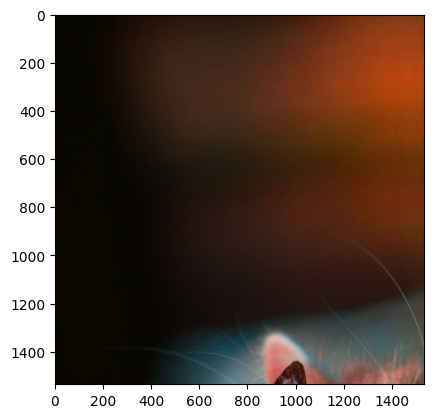

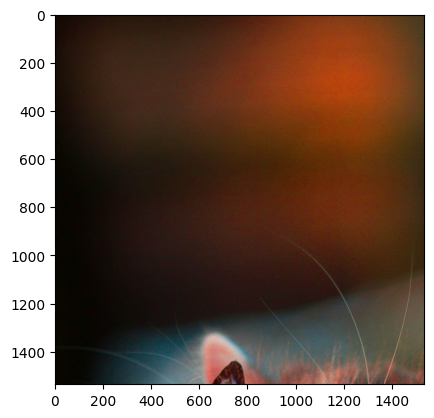

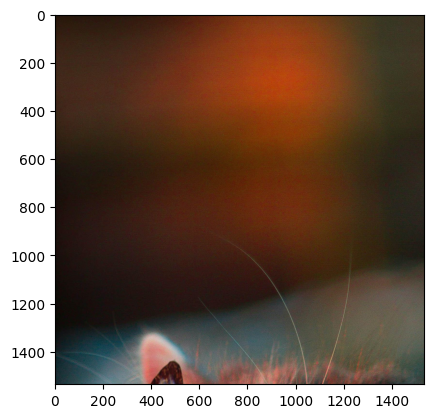

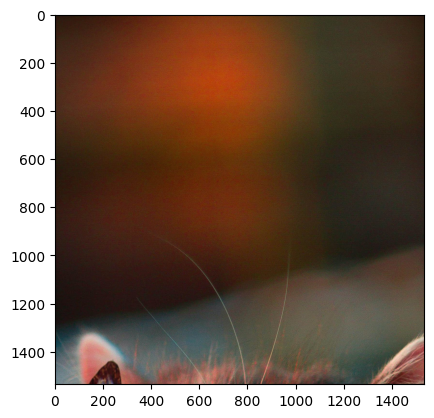

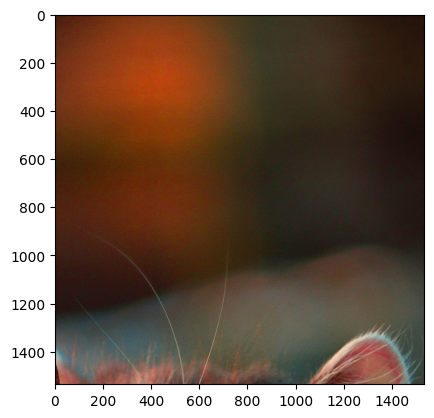

...

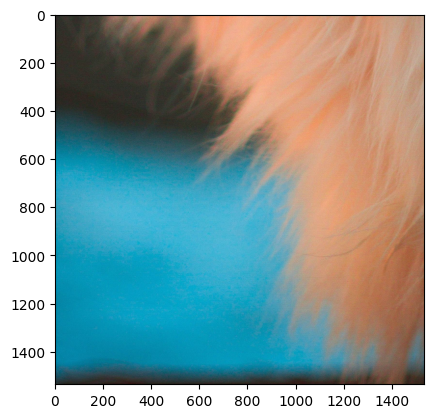

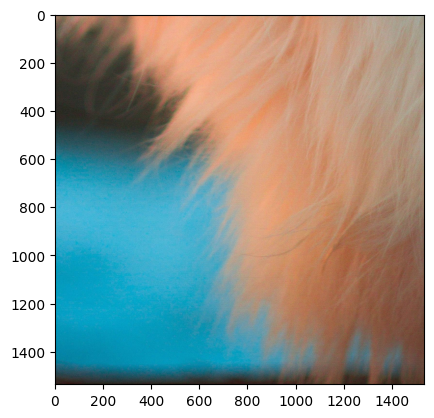

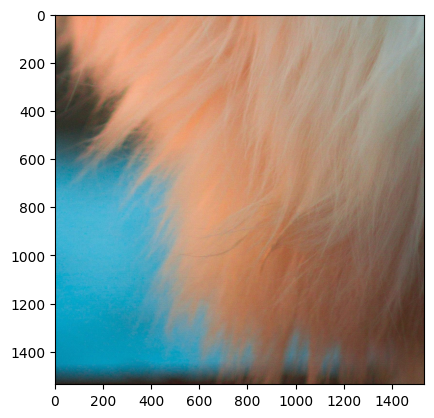

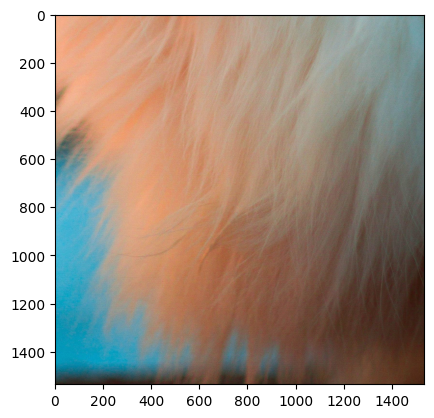

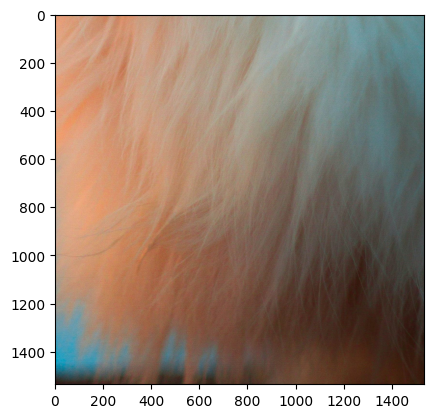

In [ ]:
window = 6
stride = 1

# window slides from top to bottom
for Y in range(0, patches.shape[1]-window+1, stride):
    # window slides from left to right
    for X in range(0, patches.shape[2]-window+1, stride):
        # initialize an empty big_patch array
        big_patch = torch.zeros(patch*window, patch*window, 3)
        # this gets the current batch of patches that will make big_batch
        patch_batch = patches[0, Y:Y+window, X:X+window]
        # loop through each patch in current batch
        for y in range(patch_batch.shape[1]):
            for x in range(patch_batch.shape[0]):
                # add patch to big_patch
                big_patch[
                    y*patch:(y+1)*patch, x*patch:(x+1)*patch, :
                ] = patch_batch[y, x].permute(1, 2, 0)
        # display current big_patch
        plt.imshow(big_patch)
        plt.show()

In [ ]:
!pip install transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 20.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 53.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 55.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 35.7 MB/s eta 0:00:00
  Attempting uninstall: huggingface-hub
    Found existing installation: huggingface-hub 0.18.0
    Uninstalling huggingface-hub-0.18.0:
      Successfully uninstalled huggingface-hub-0.18.0


In [ ]:
from transformers import CLIPProcessor, CLIPModel
import torch

# define processor and model
model_id = "openai/clip-vit-base-patch32"

processor = CLIPProcessor.from_pretrained(model_id)
model = CLIPModel.from_pretrained(model_id)

# move model to device if possible
device = 'cuda' if torch.cuda.is_available() else 'cpu'

model.to(device)

(…)32/resolve/main/preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

(…)tch32/resolve/main/tokenizer_config.json:   0%|          | 0.00/568 [00:00<?, ?B/s]

(…)vit-base-patch32/resolve/main/vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

(…)vit-base-patch32/resolve/main/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

(…)base-patch32/resolve/main/tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

(…)h32/resolve/main/special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

(…)it-base-patch32/resolve/main/config.json:   0%|          | 0.00/4.19k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

CLIPModel(
  (text_model): CLIPTextTransformer(
    (embeddings): CLIPTextEmbeddings(
      (token_embedding): Embedding(49408, 512)
      (position_embedding): Embedding(77, 512)
    )
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0-11): 12 x CLIPEncoderLayer(
          (self_attn): CLIPAttention(
            (k_proj): Linear(in_features=512, out_features=512, bias=True)
            (v_proj): Linear(in_features=512, out_features=512, bias=True)
            (q_proj): Linear(in_features=512, out_features=512, bias=True)
            (out_proj): Linear(in_features=512, out_features=512, bias=True)
          )
          (layer_norm1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): QuickGELUActivation()
            (fc1): Linear(in_features=512, out_features=2048, bias=True)
            (fc2): Linear(in_features=2048, out_features=512, bias=True)
          )
          (layer_norm2): LayerNorm((512,), eps=1e-05,

In [ ]:
window = 6
stride = 1

scores = torch.zeros(patches.shape[1], patches.shape[2])
runs = torch.ones(patches.shape[1], patches.shape[2])

for Y in range(0, patches.shape[1]-window+1, stride):
    for X in range(0, patches.shape[2]-window+1, stride):
        big_patch = torch.zeros(patch*window, patch*window, 3)
        patch_batch = patches[0, Y:Y+window, X:X+window]
        for y in range(window):
            for x in range(window):
                big_patch[
                    y*patch:(y+1)*patch, x*patch:(x+1)*patch, :
                ] = patch_batch[y, x].permute(1, 2, 0)
        # we preprocess the image and class label with the CLIP processor
        inputs = processor(
            images=big_patch,  # big patch image sent to CLIP
            return_tensors="pt",  # tell CLIP to return pytorch tensor
            text="a fluffy cat",  # class label sent to CLIP
            padding=True
        ).to(device) # move to device if possible

        # calculate and retrieve similarity score
        score = model(**inputs).logits_per_image.item()
        # sum up similarity scores from current and previous big patches
        # that were calculated for patches within the current window
        scores[Y:Y+window, X:X+window] += score
        # calculate the number of runs on each patch within the current window
        runs[Y:Y+window, X:X+window] += 1

It looks like you are trying to rescale already rescaled images. If the input images have pixel values between 0 and 1, set `do_rescale=False` to avoid rescaling them again.


In [ ]:
scores /= runs

In [ ]:
import numpy as np

In [ ]:
# clip the scores
scores = np.clip(scores-scores.mean(), 0, np.inf)

# normalize scores
scores = (
    scores - scores.min()) / (scores.max() - scores.min()
)

In [ ]:
scores.shape, patches.shape

(torch.Size([20, 13]), torch.Size([1, 20, 13, 3, 256, 256]))

In [ ]:
# transform the patches tensor
adj_patches = patches.squeeze(0).permute(3, 4, 2, 0, 1)
adj_patches.shape

torch.Size([256, 256, 3, 20, 13])

In [ ]:
# multiply patches by scores
adj_patches = adj_patches * scores

# rotate patches to visualize
adj_patches = adj_patches.permute(3, 4, 2, 0, 1)
adj_patches.shape

torch.Size([20, 13, 3, 256, 256])

**Visualize Localization**

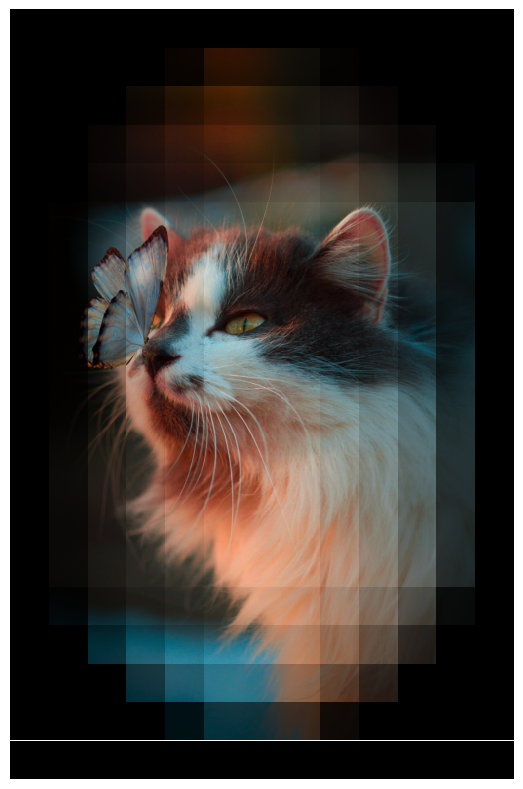

In [ ]:
Y = adj_patches.shape[0]
X = adj_patches.shape[1]

fig, ax = plt.subplots(Y, X, figsize=(X*.5, Y*.5))
for y in range(Y):
    for x in range(X):
        ax[y, x].imshow(adj_patches[y, x].permute(1, 2, 0))
        ax[y, x].axis("off")
        ax[y, x].set_aspect('equal')
plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

In [ ]:
# scores higher than 0.5 are positive
detection = scores > 0.5

In [ ]:
# non-zero positions
np.nonzero(detection)

tensor([[ 2,  5],
        [ 2,  6],
        [ 2,  7],
        [ 3,  3],
        [ 3,  4],
        [ 3,  5],
        [ 3,  6],
        [ 3,  7],
        [ 3,  8],
        [ 3,  9],
        [ 4,  3],
        [ 4,  4],
        [ 4,  5],
        [ 4,  6],
        [ 4,  7],
        [ 4,  8],
        [ 4,  9],
        [ 5,  2],
        [ 5,  3],
        [ 5,  4],
        [ 5,  5],
        [ 5,  6],
        [ 5,  7],
        [ 5,  8],
        [ 5,  9],
        [ 5, 10],
        [ 6,  2],
        [ 6,  3],
        [ 6,  4],
        [ 6,  5],
        [ 6,  6],
        [ 6,  7],
        [ 6,  8],
        [ 6,  9],
        [ 6, 10],
        [ 7,  2],
        [ 7,  3],
        [ 7,  4],
        [ 7,  5],
        [ 7,  6],
        [ 7,  7],
        [ 7,  8],
        [ 7,  9],
        [ 7, 10],
        [ 8,  2],
        [ 8,  3],
        [ 8,  4],
        [ 8,  5],
        [ 8,  6],
        [ 8,  7],
        [ 8,  8],
        [ 8,  9],
        [ 8, 10],
        [ 9,  2],
        [ 9,  3],
        [ 

In [ ]:
y_min, y_max = (
    np.nonzero(detection)[:,0].min().item(),
    np.nonzero(detection)[:,0].max().item()+1
)
y_min, y_max

(2, 18)

In [ ]:
x_min, x_max = (
    np.nonzero(detection)[:,1].min().item(),
    np.nonzero(detection)[:,1].max().item()+1
)
x_min, x_max

(2, 11)

In [ ]:
y_min *= patch
y_max *= patch
x_min *= patch
x_max *= patch
x_min, y_min

(512, 512)

In [ ]:
height = y_max - y_min
width = x_max - x_min

height, width

(4096, 2304)

In [ ]:
# image shape
img.data.numpy().shape

(3, 5184, 3456)

In [ ]:
# move color channel to final dim
image = np.moveaxis(img.data.numpy(), 0, -1)
image.shape

(5184, 3456, 3)

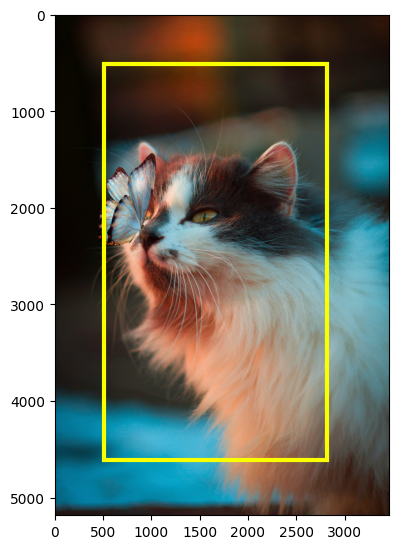

In [ ]:
import matplotlib.patches as patches

fig, ax = plt.subplots(figsize=(Y*0.5, X*0.5))

ax.imshow(image)

# Create a Rectangle patch
rect = patches.Rectangle(
    (x_min, y_min), width, height,
    linewidth=3, edgecolor='#FAFF00', facecolor='none'
)

# Add the patch to the Axes
ax.add_patch(rect)

plt.show()